<a href="https://colab.research.google.com/github/divyansingh/ACM-ICPC-Preparation/blob/master/first_defence%20final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [49]:
import tensorflow as tf
import matplotlib.pyplot as plt
import zipfile
import cv2
import os 
import numpy as np
import matplotlib.image as mpimg
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image

In [50]:
img = image.load_img("/content/a (1).jpg" , target_size=(200, 200))

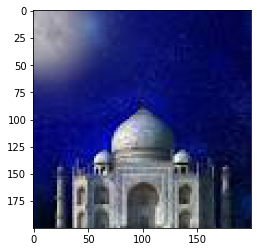

In [51]:
plt.imshow(img)

In [52]:
cv2.imread("/content/a (1).jpg")

array([[[174, 168, 169],
        [184, 178, 179],
        [192, 184, 185],
        ...,
        [ 88,  18,   5],
        [ 91,  21,   8],
        [ 91,  21,   8]],

       [[176, 170, 171],
        [185, 179, 180],
        [192, 184, 185],
        ...,
        [ 81,  11,   0],
        [ 84,  14,   1],
        [ 84,  14,   1]],

       [[180, 174, 175],
        [186, 180, 181],
        [191, 183, 184],
        ...,
        [ 81,   9,   0],
        [ 84,  12,   2],
        [ 85,  13,   3]],

       ...,

       [[ 35,  13,   1],
        [ 32,  13,   0],
        [ 31,  10,   2],
        ...,
        [ 40,  12,   5],
        [ 36,   8,   1],
        [ 38,  10,   3]],

       [[ 35,  13,   1],
        [ 32,  13,   0],
        [ 31,  10,   2],
        ...,
        [ 38,  12,   5],
        [ 34,   8,   1],
        [ 36,  10,   3]],

       [[ 35,  13,   1],
        [ 32,  13,   0],
        [ 31,  10,   2],
        ...,
        [ 38,  12,   5],
        [ 34,   8,   1],
        [ 36,  10,   3]]

In [53]:
cv2.imread("/content/a (1).jpg").shape

(100, 100, 3)

In [55]:
!unrar x "/content/basedata.rar" -d "/content/base new"


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/basedata.rar

Creating    /content/base new/basedata                                OK
Creating    /content/base new/basedata/test                           OK
Creating    /content/base new/basedata/test/qutub minar               OK
Extracting  /content/base new/basedata/test/qutub minar/a (1).jpg          0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (10).jpg         0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (11).jpg         0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (12).jpg         0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (13).jpg         0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (14).jpg         0%  OK 
Extracting  /content/base new/basedata/test/qutub minar/a (15).jpg         0%  OK 
Extracting  /content/base new

In [56]:
train_datagen = ImageDataGenerator(rescale=1/255)
validation_datagen = ImageDataGenerator(rescale=1/255)

In [57]:
train_generator = train_datagen.flow_from_directory(
        '/content/base new/basedata/test',  # This is the source directory for training images
        target_size=(200, 200),  # All images will be resized to 150x150
        batch_size=128,
        # Since we use binary_crossentropy loss, we need binary labels
        class_mode='binary')

validation_generator = train_datagen.flow_from_directory(
        '/content/base new/basedata/validation',  # This is the source directory for training images
        target_size=(200, 200),  # All images will be resized to 150x150
        batch_size=128,
        # Since we use binary_crossentropy loss, we need binary labels
        class_mode='binary') 

Found 204 images belonging to 2 classes.
Found 204 images belonging to 2 classes.


In [58]:
train_generator.class_indices

{'qutub minar': 0, 'tajmahal': 1}

In [59]:
train_generator.classes

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1], dtype=int32)

In [60]:
from tensorflow.keras.optimizers import RMSprop

model = tf.keras.models.Sequential([
    # Note the input shape is the desired size of the image 150x150 with 3 bytes color
    # This is the first convolution
    tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(200, 200, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    # The second convolution
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # The third convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # The fourth convolution
    #tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    #tf.keras.layers.MaxPooling2D(2,2),
    # The fifth convolution
    #tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    #tf.keras.layers.MaxPooling2D(2,2),
    # Flatten the results to feed into a DNN
    tf.keras.layers.Flatten(),
    # 512 neuron hidden layer
    tf.keras.layers.Dense(512, activation='relu'),
    # Only 1 output neuron. It will contain a value from 0-1 where 0 for 1 class ('horses') and 1 for the other ('humans')
    tf.keras.layers.Dense(1, activation='sigmoid')
])

model.compile(loss='binary_crossentropy',
              optimizer=RMSprop(lr=0.001),
              metrics=['accuracy'])

In [61]:
history = model.fit(
      train_generator,
      steps_per_epoch=1,  
      epochs=30,
      validation_data = validation_generator,callbacks=[callbacks])

Epoch 1/30
1/1 [==============================] - 3s 3s/step - loss: 0.6757 - accuracy: 0.7500 - val_loss: 15.6137 - val_accuracy: 0.7353
Epoch 2/30
1/1 [==============================] - 2s 2s/step - loss: 16.3733 - accuracy: 0.7266 - val_loss: 3.0556 - val_accuracy: 0.2647
Epoch 3/30
1/1 [==============================] - 2s 2s/step - loss: 3.0280 - accuracy: 0.2656 - val_loss: 1.5278 - val_accuracy: 0.7353
Epoch 4/30
1/1 [==============================] - 2s 2s/step - loss: 1.6547 - accuracy: 0.7109 - val_loss: 0.5432 - val_accuracy: 0.7402
Epoch 5/30
1/1 [==============================] - 2s 2s/step - loss: 0.5501 - accuracy: 0.7344 - val_loss: 0.5172 - val_accuracy: 0.7451
Epoch 6/30
1/1 [==============================] - 2s 2s/step - loss: 0.5307 - accuracy: 0.7266 - val_loss: 0.4515 - val_accuracy: 0.7598
Epoch 7/30
1/1 [==============================] - 2s 2s/step - loss: 0.4724 - accuracy: 0.7368 - val_loss: 1.3970 - val_accuracy: 0.2647
Epoch 8/30
1/1 [=======================

In [10]:
class myCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self,epoch,logs={}):
        if (logs.get('accuracy') > .98) & (logs.get('val_accuracy') > .9):
            print("Reached 98% accuracy so cancelling training!")
            self.model.stop_training = True
callbacks = myCallback()

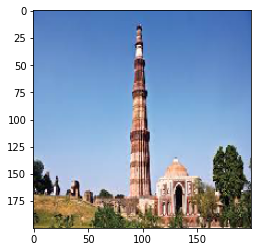

Qutub minar


In [67]:
 img = img = image.load_img("/content/base new/basedata/test/qutub minar/a (37).jpg" , target_size=(200, 200))
plt.imshow(img)
plt.show()
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
images = np.vstack([x])
classes =model.predict(images)
if classes[0]==0:
       print("Qutub minar")
else:
       print("taj mahal")

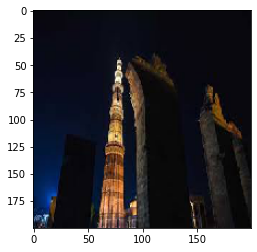

Qutub minar


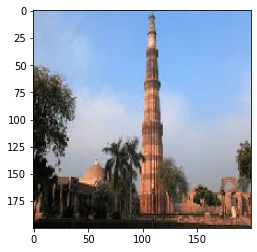

taj mahal


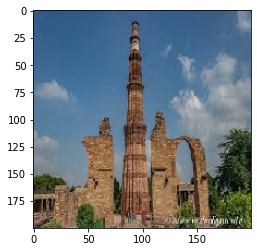

Qutub minar


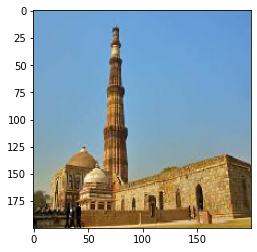

Qutub minar


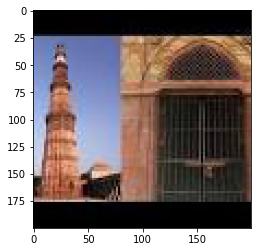

taj mahal


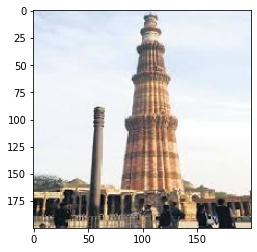

Qutub minar


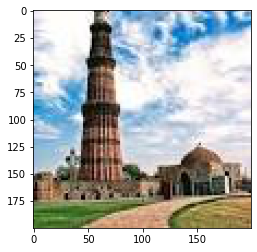

taj mahal


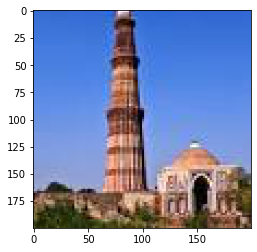

Qutub minar


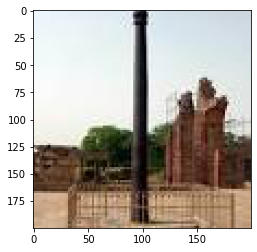

Qutub minar


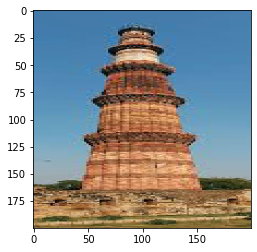

Qutub minar


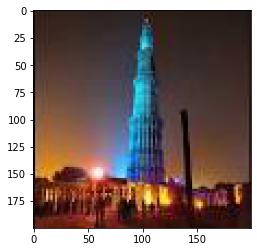

Qutub minar


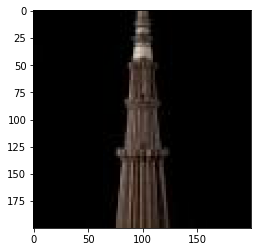

Qutub minar


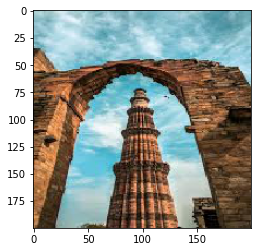

taj mahal


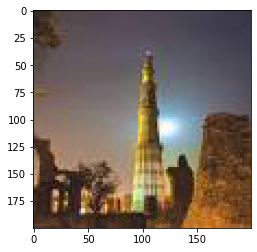

taj mahal


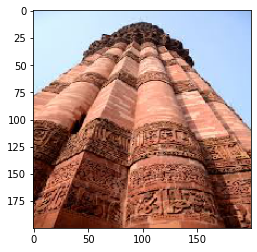

taj mahal


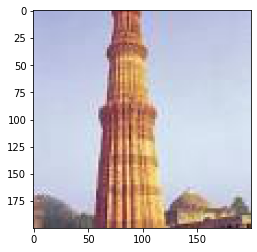

Qutub minar


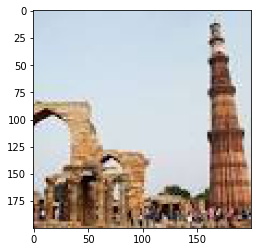

taj mahal


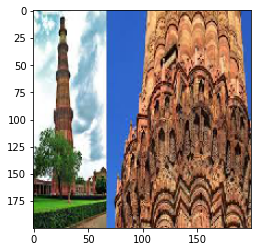

taj mahal


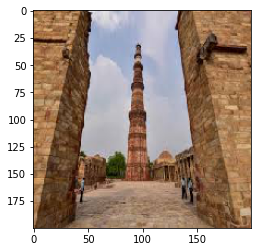

taj mahal


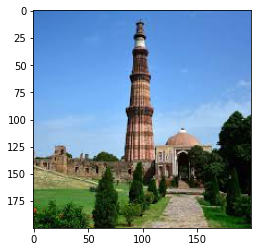

Qutub minar


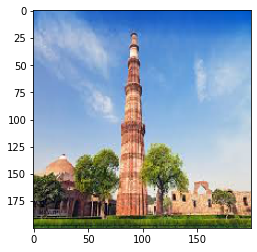

Qutub minar


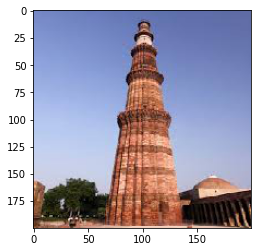

Qutub minar


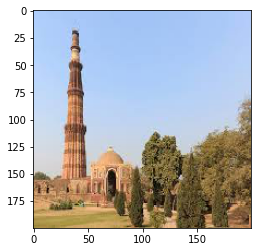

taj mahal


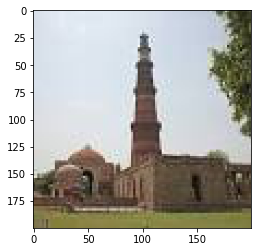

Qutub minar


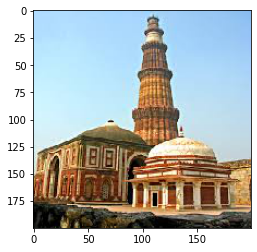

taj mahal


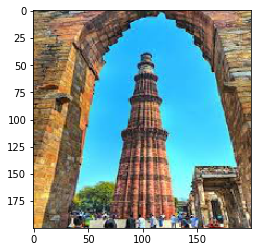

Qutub minar


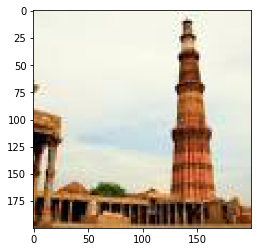

taj mahal


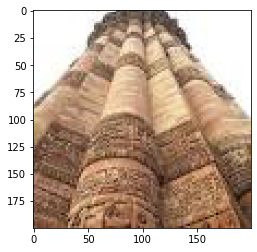

taj mahal


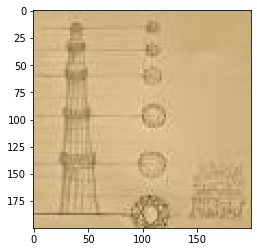

taj mahal


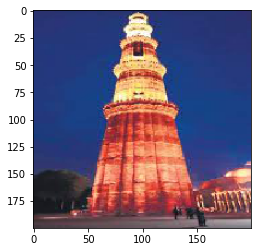

Qutub minar


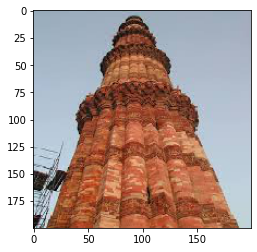

taj mahal


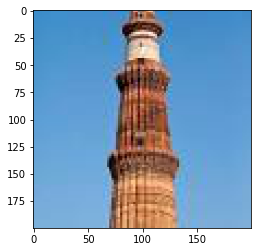

Qutub minar


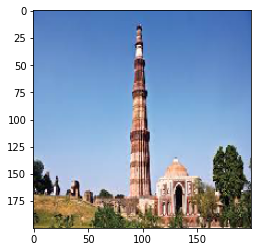

Qutub minar


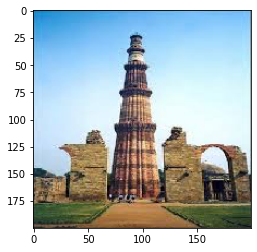

Qutub minar


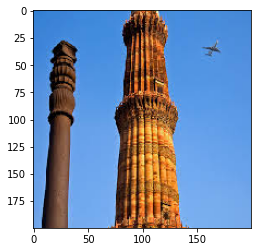

Qutub minar


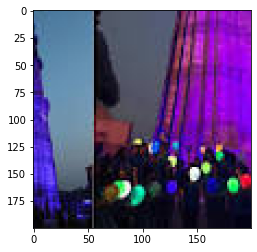

taj mahal


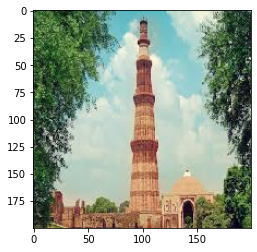

taj mahal


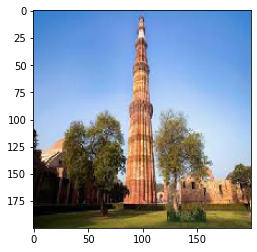

Qutub minar


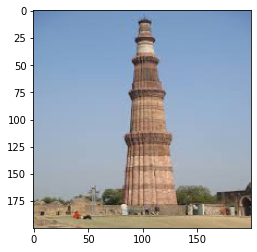

Qutub minar


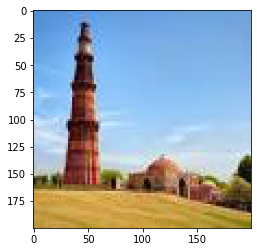

taj mahal


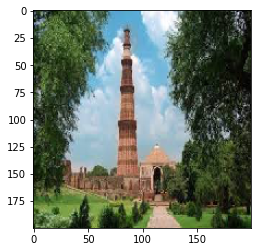

taj mahal


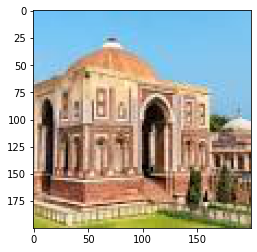

taj mahal


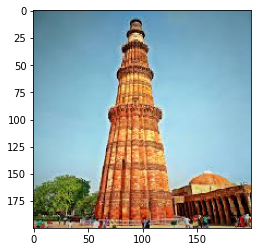

Qutub minar


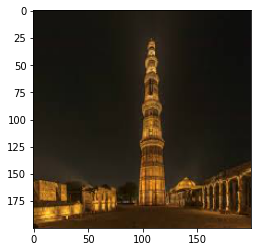

Qutub minar


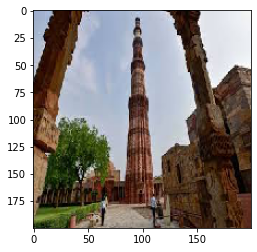

taj mahal


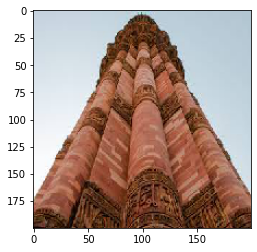

taj mahal


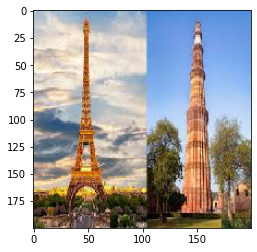

taj mahal


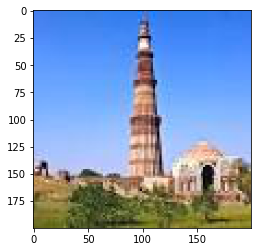

taj mahal


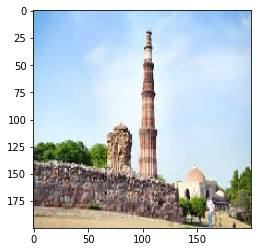

Qutub minar


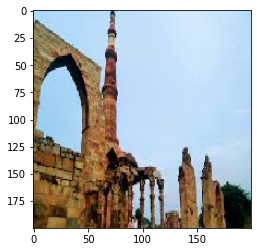

Qutub minar


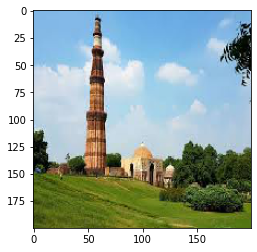

taj mahal


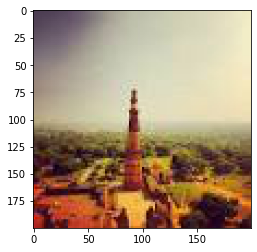

Qutub minar


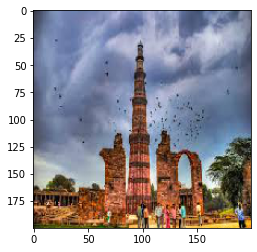

Qutub minar


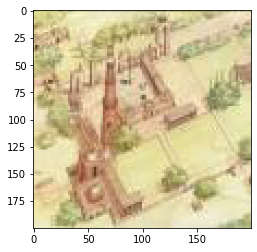

taj mahal


In [64]:
dir_path = "/content/base new/basedata/test/qutub minar"
for i in os.listdir(dir_path):
    img = image.load_img(dir_path+ '//' + i , target_size=(200, 200))
    plt.imshow(img)
    plt.show()
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])

    classes =model.predict(images)
    if classes[0]==0:
        print("Qutub minar")
    else:
        print("taj mahal")

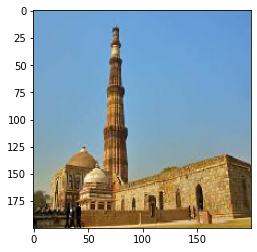

Qutub minar


In [65]:
 img = img = image.load_img("/content/base new/basedata/test/qutub minar/a (42).jpg" , target_size=(200, 200))
plt.imshow(img)
plt.show()
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
images = np.vstack([x])
classes =model.predict(images)
if classes[0]==0:
       print("Qutub minar")
else:
       print("taj mahal")

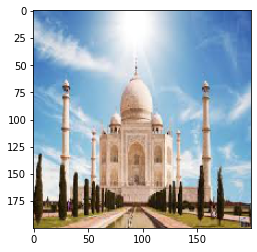

taj mahal


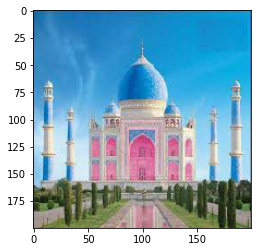

taj mahal


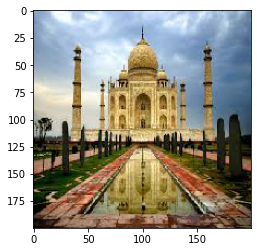

taj mahal


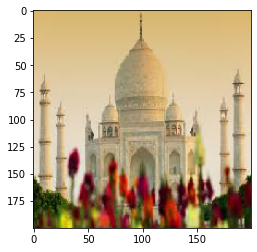

taj mahal


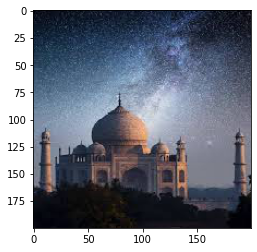

taj mahal


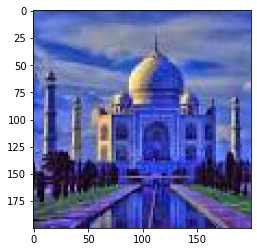

taj mahal


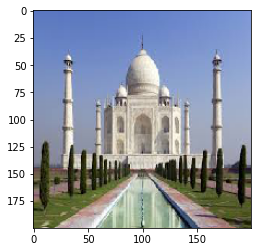

taj mahal


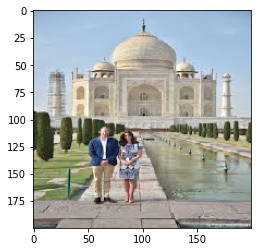

taj mahal


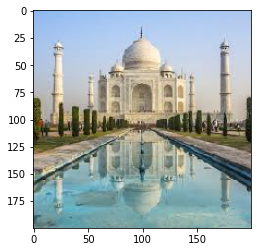

taj mahal


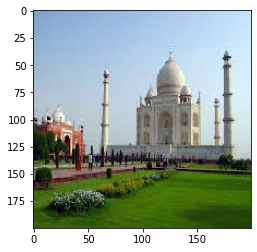

taj mahal


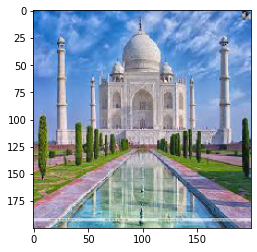

taj mahal


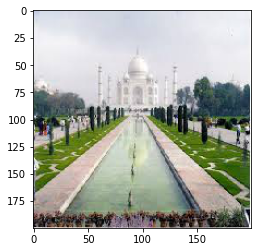

taj mahal


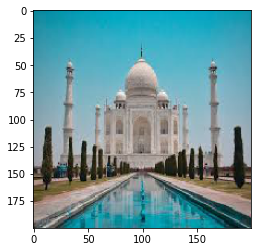

taj mahal


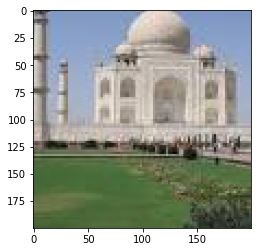

taj mahal


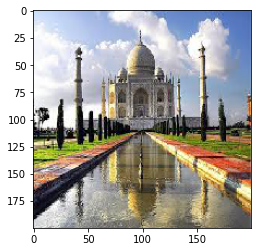

taj mahal


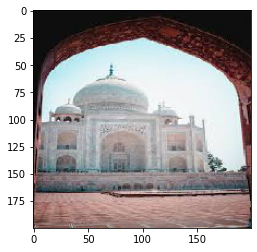

taj mahal


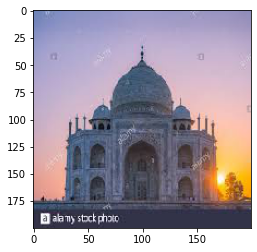

taj mahal


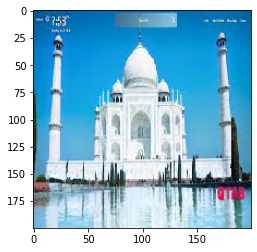

taj mahal


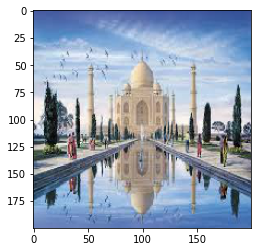

taj mahal


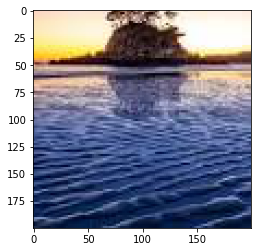

taj mahal


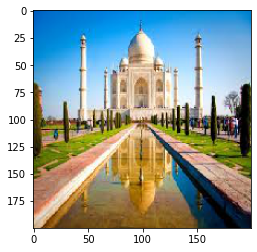

taj mahal


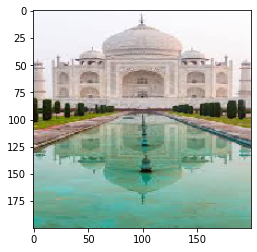

taj mahal


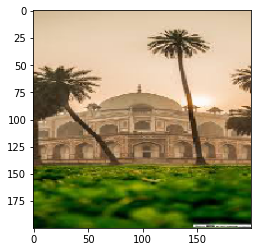

taj mahal


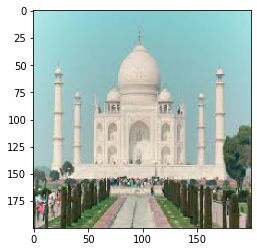

taj mahal


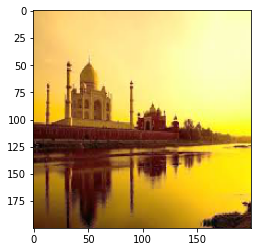

taj mahal


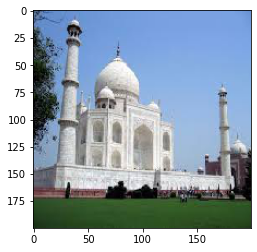

taj mahal


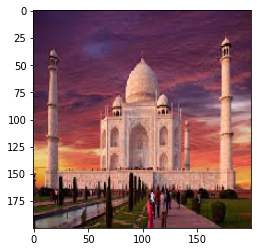

taj mahal


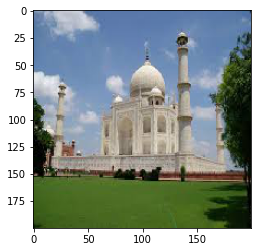

taj mahal


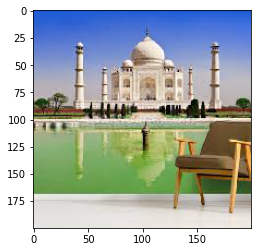

taj mahal


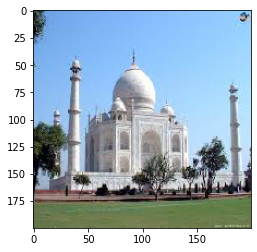

taj mahal


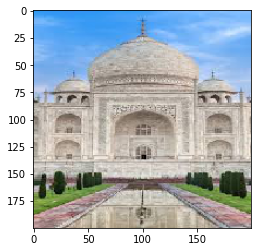

taj mahal


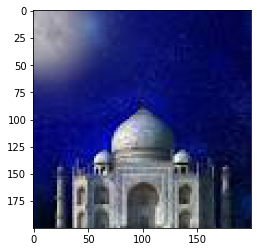

taj mahal


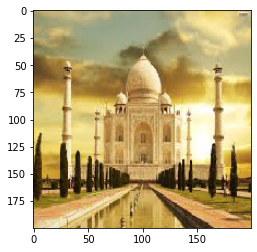

taj mahal


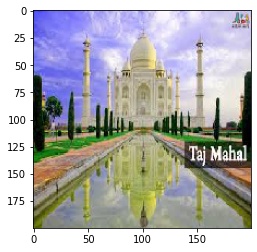

taj mahal


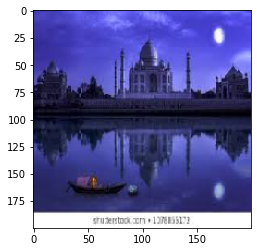

taj mahal


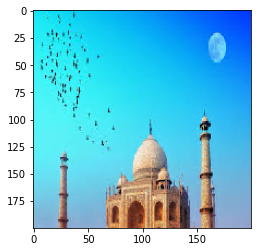

taj mahal


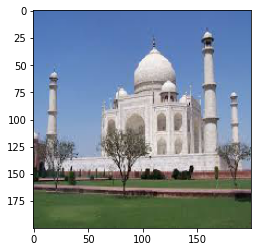

taj mahal


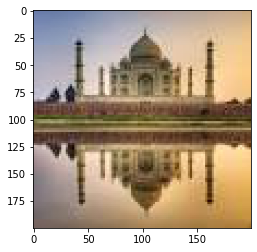

taj mahal


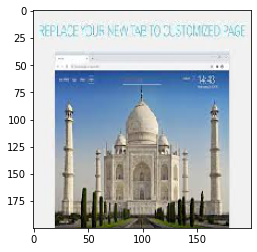

taj mahal


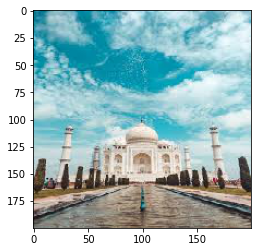

taj mahal


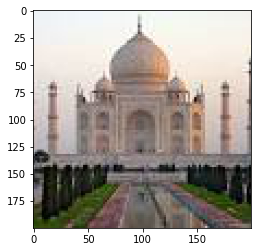

taj mahal


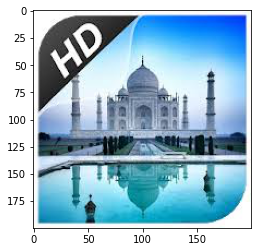

taj mahal


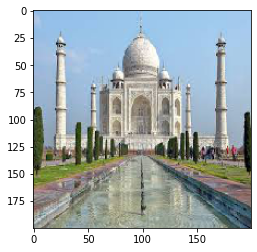

taj mahal


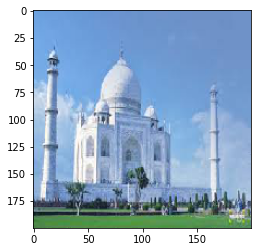

taj mahal


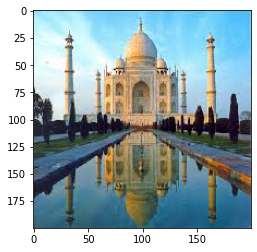

taj mahal


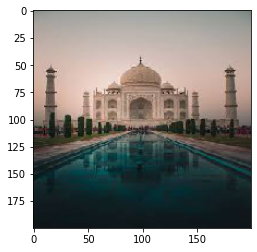

taj mahal


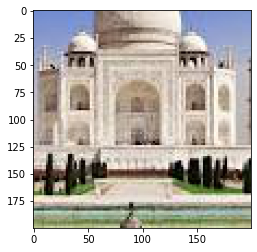

taj mahal


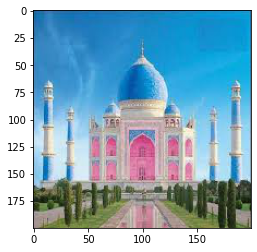

taj mahal


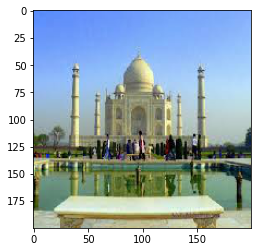

taj mahal


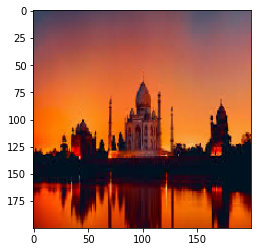

taj mahal


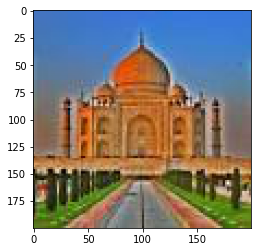

taj mahal


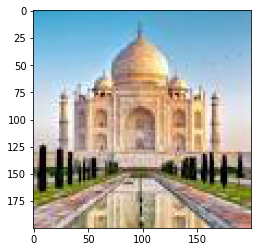

taj mahal


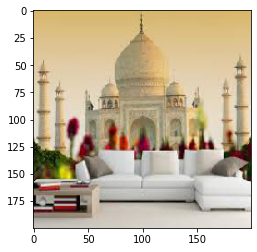

taj mahal


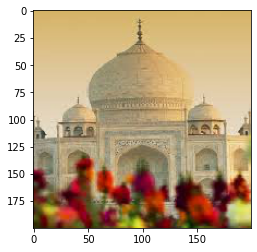

taj mahal


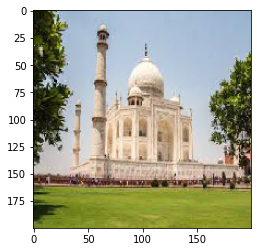

taj mahal


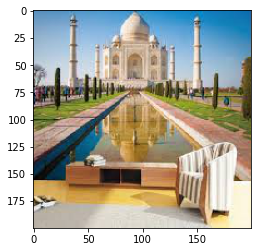

taj mahal


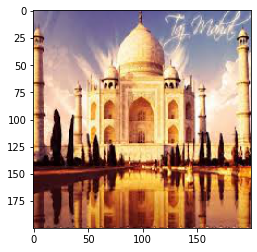

taj mahal


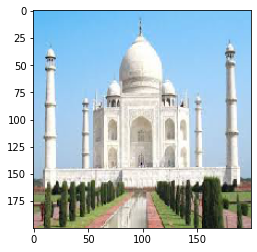

taj mahal


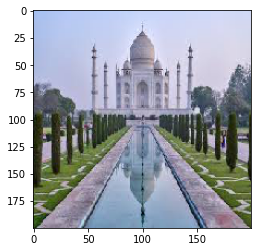

taj mahal


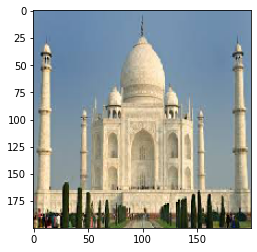

taj mahal


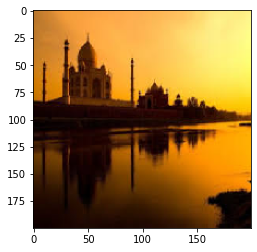

taj mahal


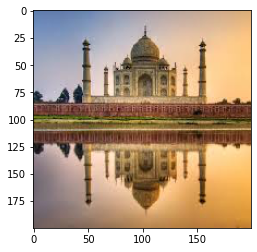

taj mahal


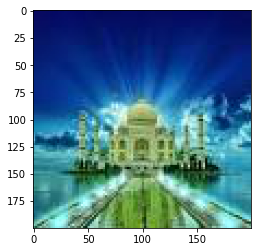

taj mahal


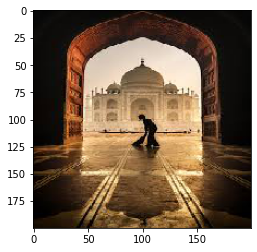

taj mahal


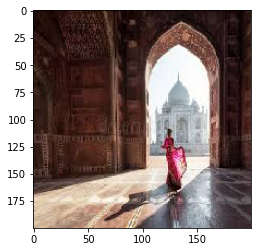

taj mahal


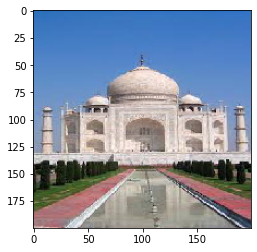

taj mahal


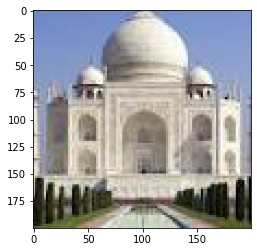

taj mahal


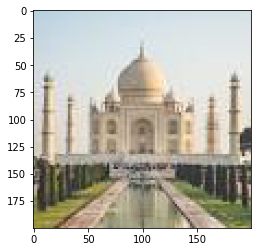

taj mahal


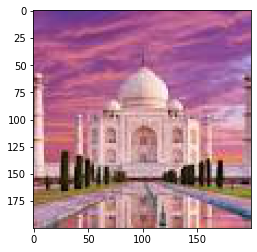

taj mahal


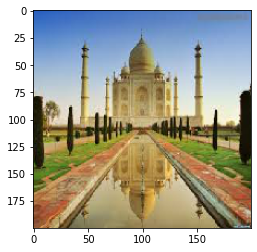

taj mahal


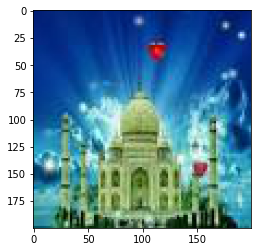

taj mahal


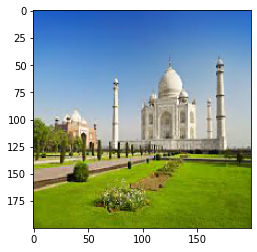

taj mahal


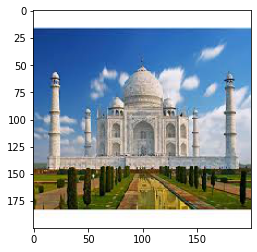

taj mahal


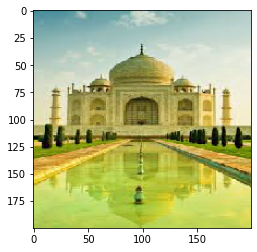

taj mahal


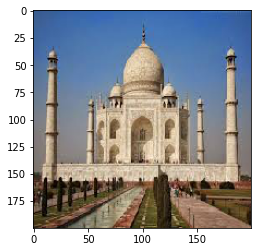

taj mahal


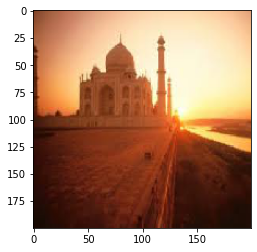

taj mahal


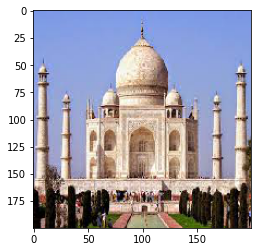

taj mahal


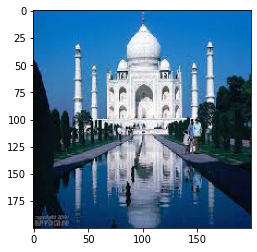

taj mahal


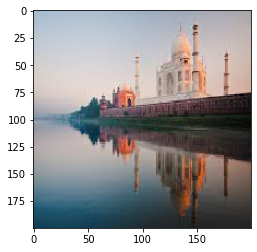

taj mahal


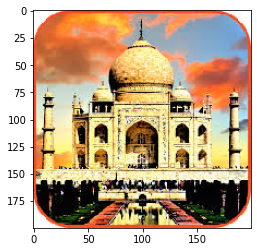

taj mahal


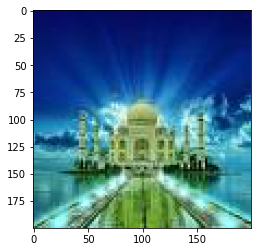

taj mahal


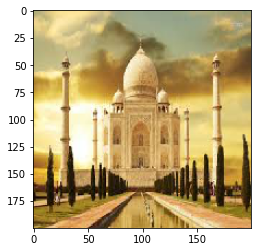

taj mahal


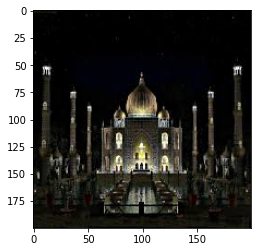

taj mahal


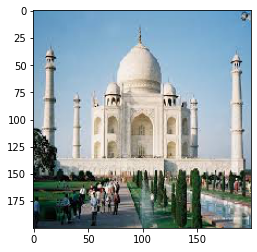

taj mahal


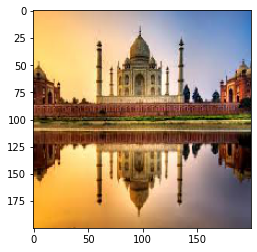

taj mahal


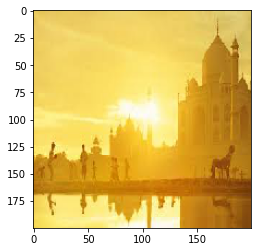

taj mahal


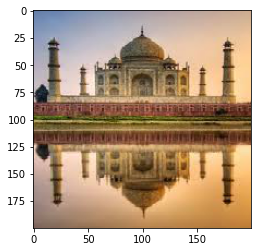

taj mahal


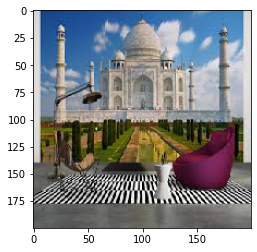

taj mahal


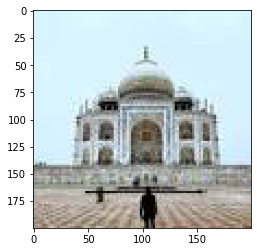

taj mahal


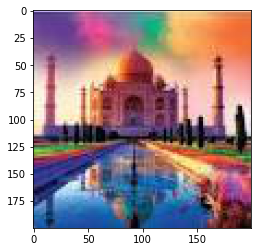

taj mahal


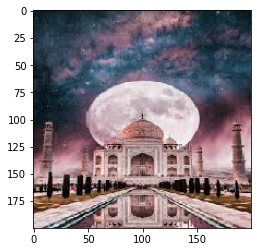

taj mahal


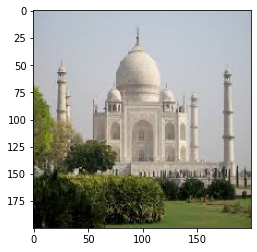

taj mahal


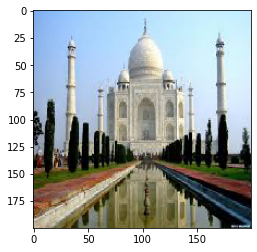

taj mahal


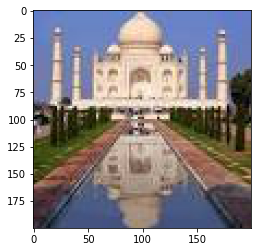

taj mahal


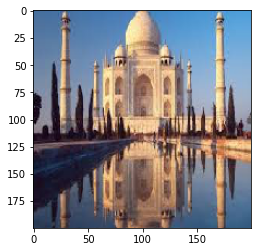

taj mahal


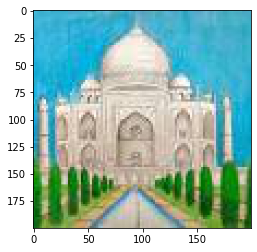

taj mahal


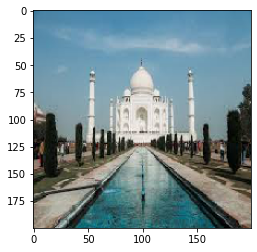

taj mahal


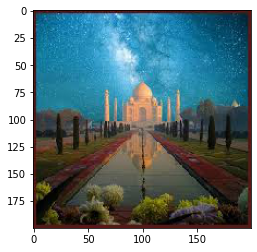

taj mahal


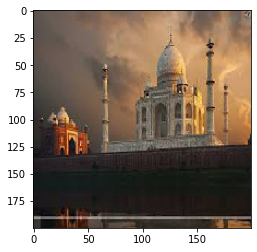

taj mahal


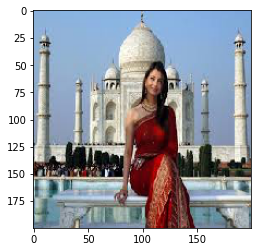

taj mahal


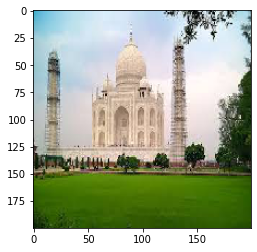

taj mahal


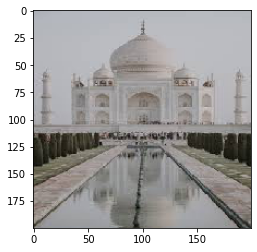

taj mahal


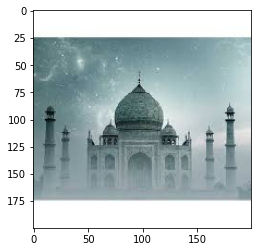

taj mahal


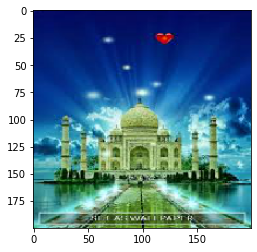

taj mahal


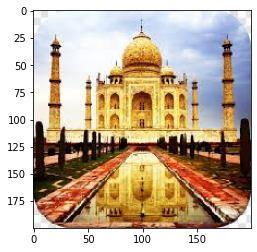

taj mahal


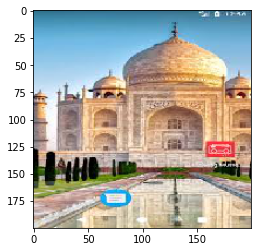

taj mahal


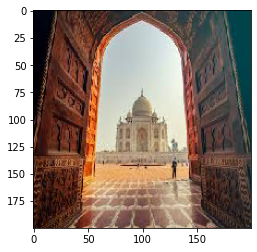

taj mahal


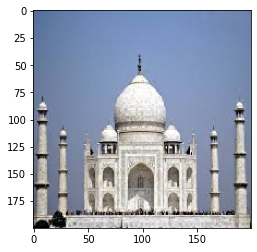

taj mahal


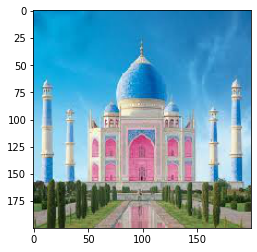

taj mahal


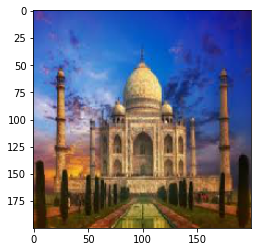

taj mahal


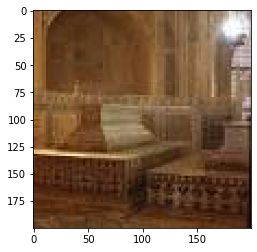

taj mahal


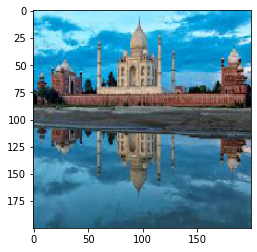

taj mahal


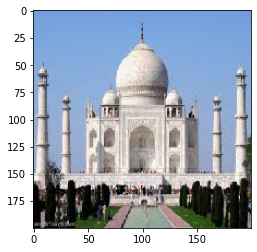

taj mahal


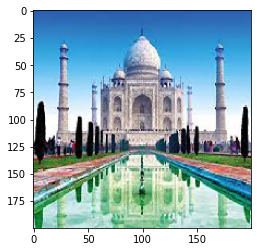

taj mahal


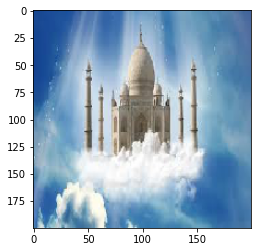

taj mahal


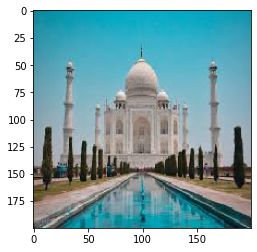

taj mahal


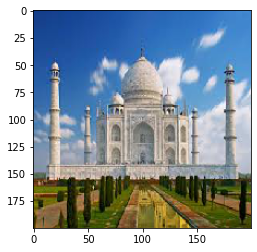

taj mahal


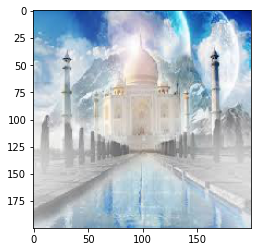

taj mahal


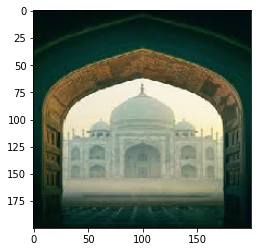

taj mahal


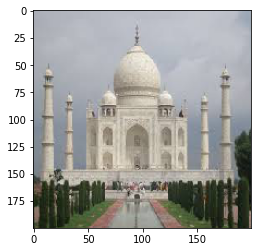

taj mahal


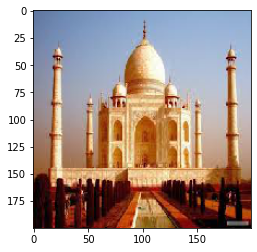

taj mahal


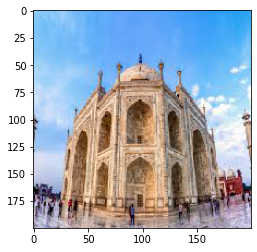

taj mahal


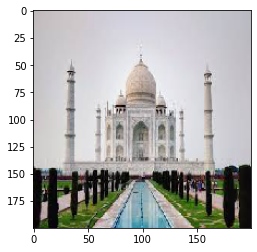

taj mahal


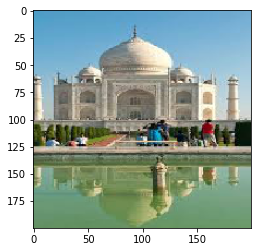

taj mahal


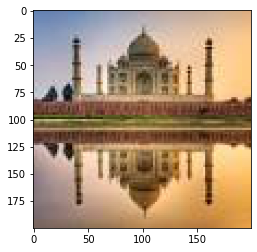

taj mahal


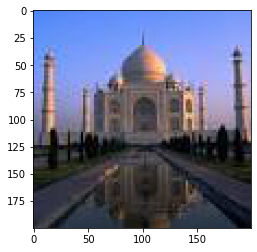

taj mahal


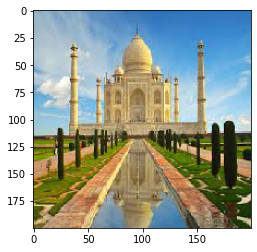

taj mahal


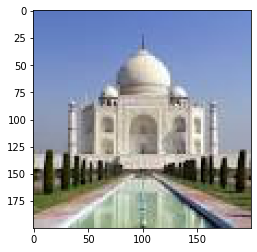

taj mahal


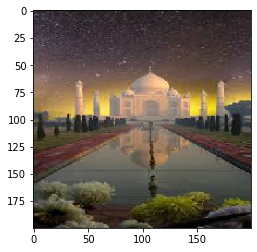

taj mahal


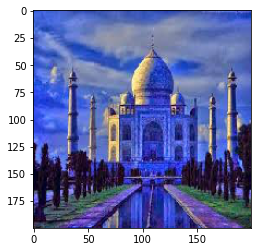

taj mahal


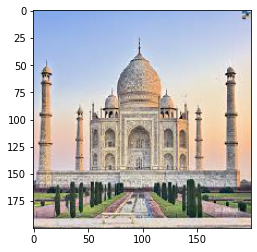

taj mahal


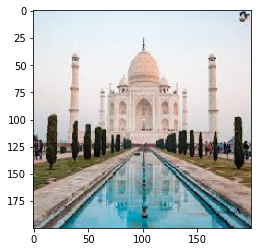

taj mahal


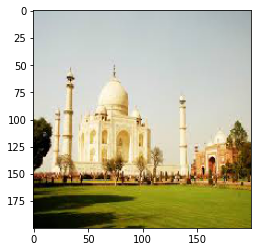

taj mahal


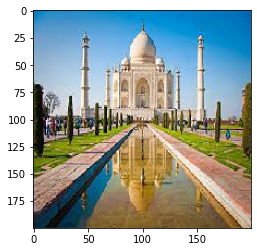

taj mahal


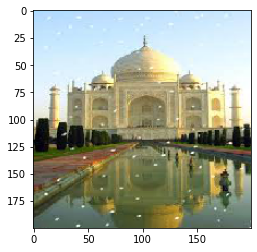

taj mahal


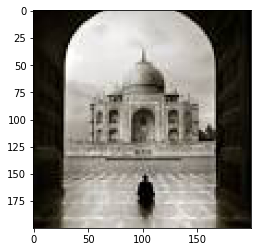

taj mahal


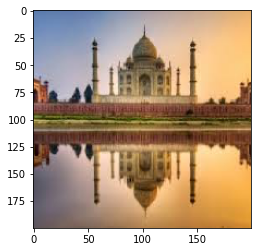

taj mahal


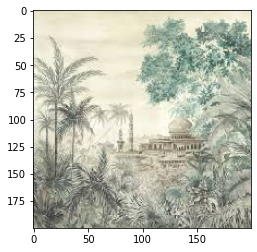

taj mahal


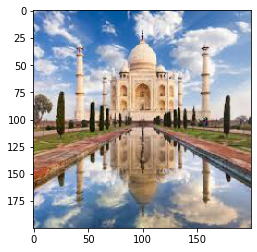

taj mahal


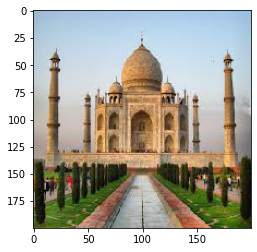

taj mahal


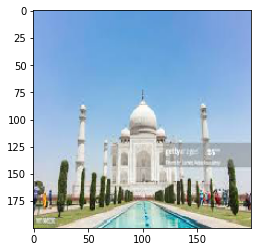

taj mahal


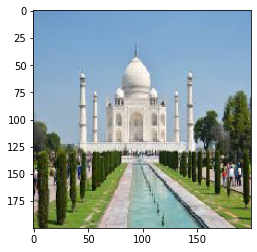

taj mahal


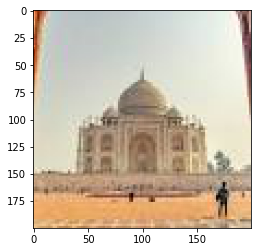

taj mahal


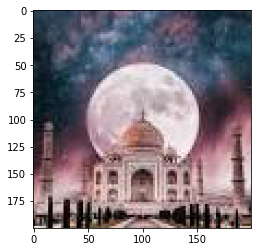

taj mahal


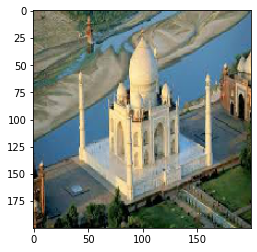

taj mahal


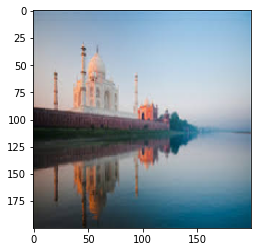

taj mahal


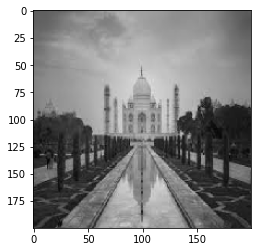

taj mahal


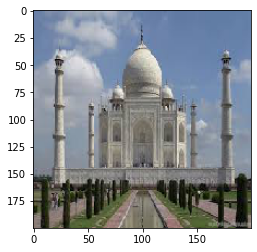

taj mahal


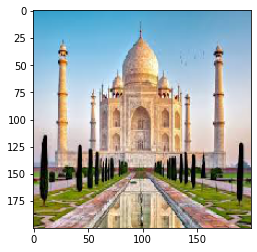

taj mahal


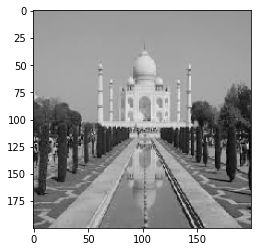

taj mahal


In [38]:
dir_path = "/content/base/basedata/test/tajmahal"
for i in os.listdir(dir_path):
    img = image.load_img(dir_path+ '//' + i , target_size=(200, 200))
    plt.imshow(img)
    plt.show()
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])

    classes =model.predict(images)
    if classes[0]==0:
        print("Qutub minar")
    else:
        print("taj mahal")

In [39]:
!unrar x "/content/test 1.rar" -d "/content/base"


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/test 1.rar

Creating    /content/base/test 1                                      OK
Extracting  /content/base/test 1/a (1).jpg                                 4%  OK 
Extracting  /content/base/test 1/a (10).jpg                               14%  OK 
Extracting  /content/base/test 1/a (11).jpg                               30%  OK 
Extracting  /content/base/test 1/a (2).jpg                                32%  OK 
Extracting  /content/base/test 1/a (32).jpg                               47%  OK 
Extracting  /content/base/test 1/a (5).jpg                                66%  OK 
Extracting  /content/base/test 1/a (52).jpg                               69%  OK 
Extracting  /content/base/test 1/a (6).jpg                                84%  OK 
Extracting  /content/base/test 1/a (9).jpg                                99%

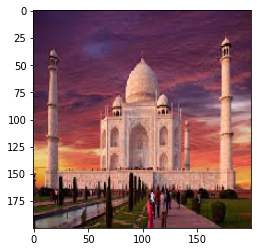

taj mahal


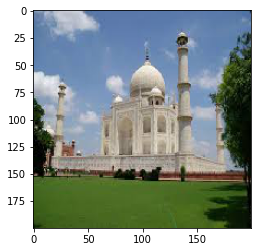

taj mahal


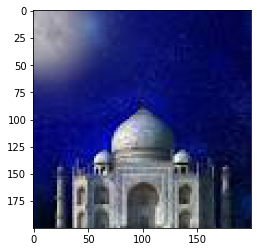

taj mahal


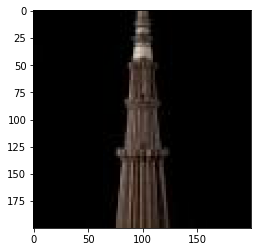

Qutub minar


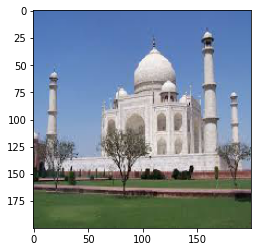

taj mahal


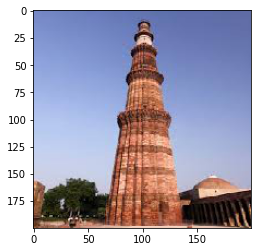

Qutub minar


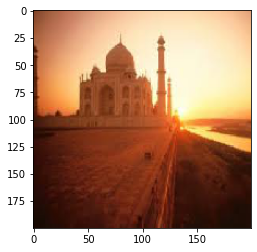

taj mahal


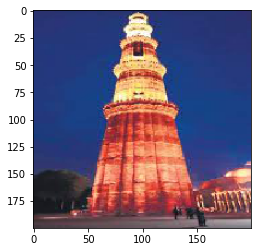

Qutub minar


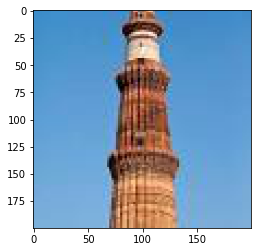

Qutub minar


In [69]:
dir_path = "/content/base/test 1"
for i in os.listdir(dir_path):
    img = image.load_img(dir_path+ '//' + i , target_size=(200, 200))
    plt.imshow(img)
    plt.show()
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])

    classes =model.predict(images)
    if classes[0]==0:
        print("Qutub minar")
    else:
        print("taj mahal")

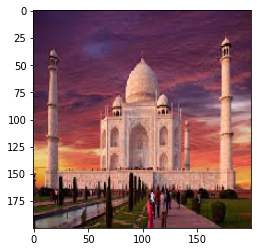

taj mahal


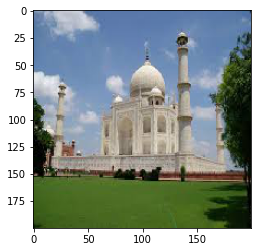

taj mahal


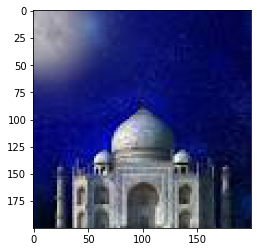

taj mahal


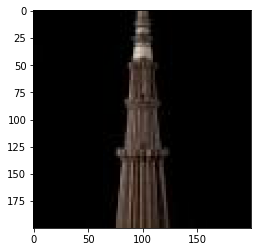

Qutub minar


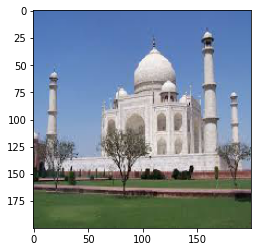

taj mahal


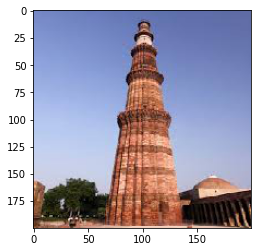

Qutub minar


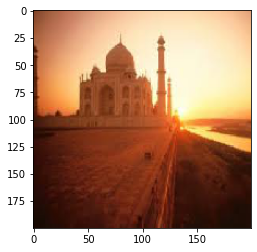

taj mahal


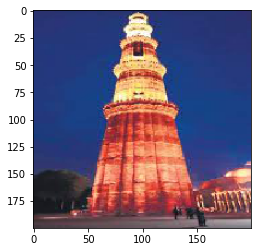

Qutub minar


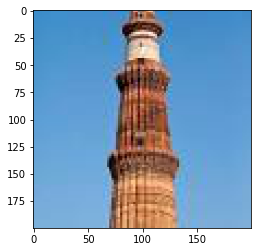

Qutub minar


In [68]:
dir_path = "/content/base/test 1"
for i in os.listdir(dir_path):
    img = image.load_img(dir_path+ '//' + i , target_size=(200, 200))
    plt.imshow(img)
    plt.show()
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])

    classes =model.predict(images)
    if classes[0]==0:
        print("Qutub minar")
    else:
        print("taj mahal")
        